In [5]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from sklearn.linear_model import LogisticRegression
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import dash
from dash import dcc, html, Input, Output, State

In [7]:
df = pd.read_csv("heart_attack_south_africa.csv")
df

,Patient_ID,Age,Gender,Cholesterol_Level,Blood_Pressure_Systolic,Blood_Pressure_Diastolic,Smoking_Status,Alcohol_Intake,Physical_Activity,Obesity_Index,Diabetes_Status,Family_History_Heart_Disease,Diet_Quality,Stress_Level,Heart_Attack_History,Medication_Usage,Triglycerides_Level,LDL_Level,HDL_Level,Heart_Attack_Outcome
0,1,76,Female,156,94,79,No,High,Sedentary,35.2,No,No,Good,High,No,No,264,141,65,0
1,2,39,Female,160,185,88,No,Low,Sedentary,21.3,No,No,Average,Medium,No,Yes,150,81,42,0
2,3,85,Male,254,173,113,Yes,Moderate,Highly Active,32.0,Yes,No,Good,Low,No,No,220,124,70,1
3,4,45,Female,261,187,65,No,High,Sedentary,36.4,No,Yes,Average,Low,No,Yes,141,56,38,1
4,5,48,Male,206,189,84,No,Low,Active,26.6,No,No,Good,High,No,No,221,186,26,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,99996,55,Female,187,159,88,Yes,Moderate,Sedentary,32.9,No,No,Average,High,No,Yes,225,158,48,1
99996,99997,84,Male,172,169,86,Yes,Low,Active,24.0,No,No,Poor,Medium,No,No,159,110,24,1
99997,99998,67,Female,299,134,90,No,Low,Active,32.4,Yes,Yes,Average,Low,Yes,No,219,141,22,1
99998,99999,33,Male,221,160,99,No,High,Active,39.1,No,Yes,Average,High,No,Yes,131,191,61,1


**Interactive 3D Scatter Plot of Heart Attack Risk Factors**

Tasks:

Map:

x-axis: Age

y-axis: Cholesterol_Level

z-axis: Blood_Pressure_Systolic

● Use the Heart_Attack_Outcome to determine marker colors (e.g., 0 = no heart attack, 1 = heart attack).

● Include hover text that shows additional details (e.g., Gender, Diabetes_Status, Obesity_Index).

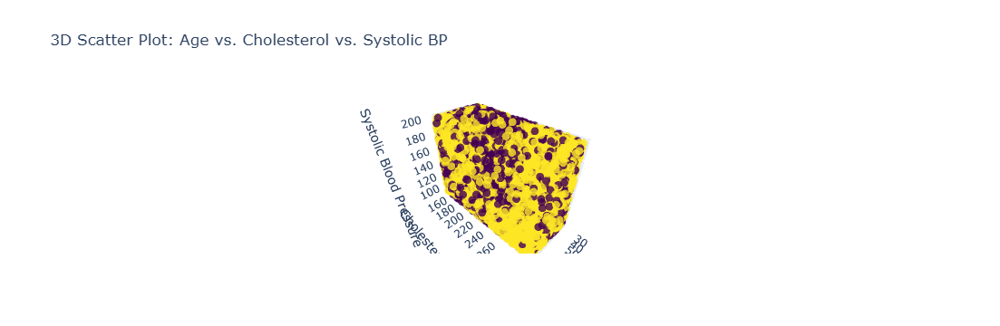

In [11]:

# Create the 3D scatter plot
fig = go.Figure(data=go.Scatter3d(
    x=df['Age'],
    y=df['Cholesterol_Level'],
    z=df['Blood_Pressure_Systolic'],
    mode='markers',
    marker=dict(
        size=5,
        color=df['Heart_Attack_Outcome'],  # binary outcome (e.g., 0 or 1)
        colorscale='Viridis',
        opacity=0.8
    ),
    text=[f"Diabetes: {d}, Smoking: {s}" for d, s in zip(df['Diabetes_Status'], df['Smoking_Status'])]
))

fig.update_layout(
    title="3D Scatter Plot: Age vs. Cholesterol vs. Systolic BP",
    scene=dict(
        xaxis_title='Age',
        yaxis_title='Cholesterol Level',
        zaxis_title='Systolic Blood Pressure'
    )
)

fig.show()


**3D Surface Plot of Predicted Heart Attack Risk**

Tasks:

Model Development:

● Build a logistic regression model using Age and Cholesterol_Level as features to predict Heart_Attack_Outcome.

● Train the model on a portion of the dataset.

Surface Plot Construction:

● Create a meshgrid over a range of Age and Cholesterol_Level values.

● Use the model to predict risk probabilities over the grid.

● Visualize the risk surface with Plotly’s go.Surface, using a color scale that highlights low to high risk areas.

C:\Anaconda\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



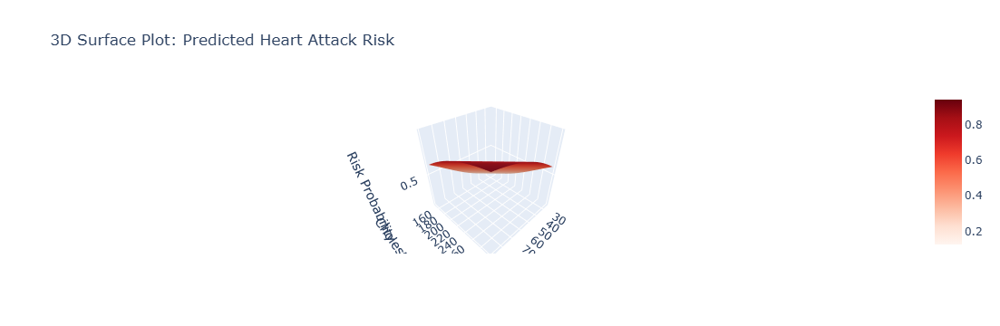

In [15]:
# Prepare features and target variable
X = df[['Age', 'Cholesterol_Level']]
y = df['Heart_Attack_Outcome']

# Train the logistic regression model
model = LogisticRegression().fit(X, y)

# Create a meshgrid for Age and Cholesterol_Level
age_range = np.linspace(df['Age'].min(), df['Age'].max(), 50)
chol_range = np.linspace(df['Cholesterol_Level'].min(), df['Cholesterol_Level'].max(), 50)
age_grid, chol_grid = np.meshgrid(age_range, chol_range)

# Predict risk probability over the grid
grid_points = np.c_[age_grid.ravel(), chol_grid.ravel()]
risk_prob = model.predict_proba(grid_points)[:, 1].reshape(age_grid.shape)

# Create the 3D surface plot
fig_surface = go.Figure(data=go.Surface(
    x=age_grid,
    y=chol_grid,
    z=risk_prob,
    colorscale='Reds'
))

fig_surface.update_layout(
    title="3D Surface Plot: Predicted Heart Attack Risk",
    scene=dict(
        xaxis_title='Age',
        yaxis_title='Cholesterol Level',
        zaxis_title='Risk Probability'
    )
)

fig_surface.show()


**Clustering Analysis with 3D Visualization**

Tasks:

Data Preparation:

● Select risk factors such as Age, Cholesterol_Level, Blood_Pressure_Systolic, and Obesity_Index.

● Preprocess the data (scaling features if necessary).

Clustering:

● Use k-means (or another clustering algorithm) to group patients into distinct clusters.

● Let students experiment with different numbers of clusters.

3D Visualization:

● Plot the clusters using Plotly’s go.Scatter3d, with each cluster assigned a distinct color.

● Add interactive hover text to display details like Patient_ID and additional risk factors.

● Include a slider or dropdown to allow users to adjust the number of clusters dynamically (via Dash callbacks).

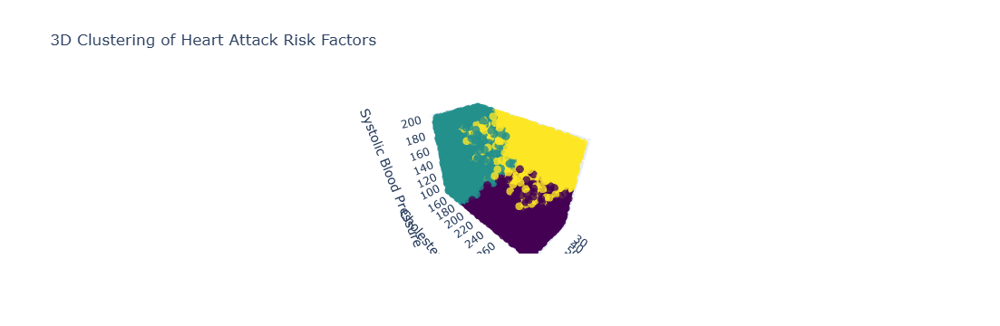

In [19]:

# Select features for clustering
features = ['Age', 'Cholesterol_Level', 'Blood_Pressure_Systolic', 'Obesity_Index']
X = df[features].dropna()  # drop any missing values if necessary

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform k-means clustering (experiment with n_clusters, e.g., 3)
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(X_scaled)

# Create a new DataFrame with cluster labels
df_cluster = X.copy()
df_cluster['Cluster'] = clusters
df_cluster['Patient_ID'] = df['Patient_ID']

# Create the 3D scatter plot with clusters
fig_cluster = go.Figure(data=go.Scatter3d(
    x=df_cluster['Age'],
    y=df_cluster['Cholesterol_Level'],
    z=df_cluster['Blood_Pressure_Systolic'],
    mode='markers',
    marker=dict(
        size=5,
        color=df_cluster['Cluster'],
        colorscale='Viridis',
        opacity=0.8
    ),
    text=[f"Patient ID: {pid}<br>Obesity Index: {oi}" for pid, oi in zip(df_cluster['Patient_ID'], df_cluster['Obesity_Index'])]
))

fig_cluster.update_layout(
    title="3D Clustering of Heart Attack Risk Factors",
    scene=dict(
        xaxis_title='Age',
        yaxis_title='Cholesterol Level',
        zaxis_title='Systolic Blood Pressure'
    )
)

fig_cluster.show()


**Data Filtering and Export Dashboard (Bar Chart)**

Tasks:

Visualization Integration (Bar Chart):

● Create a bar chart that displays the distribution of Heart_Attack_Outcome (0 = No, 1 = Yes) for the selected filters.

● The x-axis should represent Heart Attack Outcome (0 or 1).

● The y-axis should represent the number of patients in each category.

● The chart title should be: "Filtered Heart Attack Outcome Distribution (Bar Chart)".

Data Export:

● Add a button that allows users to download the filtered dataset as a CSV file.

User Experience:

● Ensure the dashboard is user-friendly and easy to navigate.

In [25]:
app = dash.Dash(__name__)

app.layout = html.Div([
    html.Div([
        html.Label("Age Range:"),
        dcc.RangeSlider(
            id='filter-age-slider',
            min=int(df['Age'].min()),
            max=int(df['Age'].max()),
            value=[int(df['Age'].min()), int(df['Age'].max())],
            marks={str(age): str(age) for age in range(int(df['Age'].min()), int(df['Age'].max())+1, 10)}
        ),
        html.Label("Select Gender:"),
        dcc.Dropdown(
            id='filter-gender-dropdown',
            options=[{'label': gen, 'value': gen} for gen in df['Gender'].unique()],
            value=df['Gender'].unique()[0],
            clearable=False
        ),
        html.Label("Smoking Status:"),
        dcc.RadioItems(
            id='filter-smoking-radio',
            options=[{'label': status, 'value': status} for status in df['Smoking_Status'].unique()],
            value=df['Smoking_Status'].unique()[0]
        ),
        html.Button("Download Filtered Data", id='download-button'),
        dcc.Download(id='download-dataframe-csv')
    ], style={'width': '30%', 'display': 'inline-block', 'verticalAlign': 'top'}),

    html.Div([
        dcc.Graph(id='filter-bar')
    ], style={'width': '68%', 'display': 'inline-block', 'padding': '0 20px'})
])

@app.callback(
    Output('filter-bar', 'figure'),
    [Input('filter-age-slider', 'value'),
     Input('filter-gender-dropdown', 'value'),
     Input('filter-smoking-radio', 'value')]
)
def update_filter_bar(selected_age, selected_gender, selected_smoking):
    filtered_df = df[
        (df['Age'] >= selected_age[0]) &
        (df['Age'] <= selected_age[1]) &
        (df['Gender'] == selected_gender) &
        (df['Smoking_Status'] == selected_smoking)
    ]

    # Group by Heart_Attack_Outcome to count occurrences
    outcome_counts = filtered_df['Heart_Attack_Outcome'].value_counts().sort_index()

    # Create a bar chart of the outcome counts
    fig = go.Figure(data=go.Bar(
        x=outcome_counts.index.astype(str),  # converting to string for clear labels ("0" or "1")
        y=outcome_counts.values,
        marker_color='lightsalmon'
    ))

    fig.update_layout(
        title="Filtered Heart Attack Outcome Distribution",
        xaxis_title="Heart Attack Outcome (0 = No, 1 = Yes)",
        yaxis_title="Number of Patients"
    )
    return fig

@app.callback(
    Output('download-dataframe-csv', 'data'),
    [Input('download-button', 'n_clicks')],
    [State('filter-age-slider', 'value'),
     State('filter-gender-dropdown', 'value'),
     State('filter-smoking-radio', 'value')]
)
def download_filtered_data(n_clicks, selected_age, selected_gender, selected_smoking):
    if n_clicks is None:
        return dash.no_update
    filtered_df = df[
        (df['Age'] >= selected_age[0]) &
        (df['Age'] <= selected_age[1]) &
        (df['Gender'] == selected_gender) &
        (df['Smoking_Status'] == selected_smoking)
    ]
    return dcc.send_data_frame(filtered_df.to_csv, "filtered_heart_attack_data.csv", index=False)

if __name__ == '__main__':
    app.run(debug=True)
